# ARIMA vs LSTM for stock price analysis

In [55]:
# internal libraries
import os
import warnings

# external libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.offline
import plotly.express as px
import plotly.graph_objects as go
import plotly.subplots as sp 
from statsmodels.tsa.seasonal import seasonal_decompose, DecomposeResult
from statsmodels.stats.stattools import durbin_watson
from statsmodels.tsa.stattools import acf, pacf
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tsa.stattools import adfuller
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer, KNNImputer
from sklearn.metrics import mean_squared_error

In [56]:
# Set project environment

FILE_PATH = os.getcwd() + "/data/AMZN.csv"

plotly.offline.init_notebook_mode()
warnings.filterwarnings("ignore")

In [57]:
# Load data and set date as index
def load_data():
    df = pd.read_csv(FILE_PATH, sep=',',decimal='.', index_col='Date', parse_dates=True)

    # lowercase column names
    df.columns = [col.lower() for col in df.columns]

    return df

df = load_data()

df.tail()

,open,high,low,close,adj close,volume
Date,,,,,,
2024-02-08,169.649994,171.429993,168.880005,169.839996,169.839996,42316500
2024-02-09,170.899994,175.000000,170.580002,174.449997,174.449997,56986000
2024-02-12,174.800003,175.389999,171.539993,172.339996,172.339996,51050400
2024-02-13,167.729996,170.949997,165.750000,168.639999,168.639999,56345100
2024-02-14,169.210007,171.210007,168.279999,170.979996,170.979996,42760600


The data used in this notebook was obtained from [Yahoo Finance](https://de.finance.yahoo.com/quote/AMZN/history?period1=863654400&period2=1707955200&interval=1d&filter=history&frequency=1d&includeAdjustedClose=true). Is contains the daily opening, closing, high and low prices and the trading volume of the Amazon stock from  15 May 1997 to 22 January 2024. Amazon is a company that has been listed on the stock exchange since 1997 and has experienced a significant increase in its stock price over the years. Amazon started as a small online bookstore and has grown into one of the largest online retailers in the world. The company has also expanded into other areas such as cloud computing, artificial intelligence and digital streaming. The stock price of Amazon has been very volatile over the years and has experienced significant fluctuations. In this notebook, we will use ARIMA and LSTM to predict the stock price of Amazon. We will compare the performance of the two models and determine which one is better for predicting the stock price of Amazon.

## Data Understanding

The data contains 6732 rows and the following columns:
- Date: The date of the trading day
- Open: The opening price 
- High: The highest price
- Low: The lowest price
- Close: The closing price
- Adj Close: The adjusted closing price
- Volume: The trading volume


The Data Understanding aims to provide a general understanding of the data and to identify the data quality issues that need to be addressed before the data can be used for analysis. 
It also paves the way for the data preparation and modelling. Since the goal of this notebook is to compare the performance of ARIMA and LSTM models, the understanding of the provided time series data is a crucial step to determine the best model for the analysis. It also helps with the evaluation of the model's performance and the interpretation of the results by providing insights into the data's characteristics and patterns.

In [58]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 6732 entries, 1997-05-15 to 2024-02-14
Data columns (total 6 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   open       6732 non-null   float64
 1   high       6732 non-null   float64
 2   low        6732 non-null   float64
 3   close      6732 non-null   float64
 4   adj close  6732 non-null   float64
 5   volume     6732 non-null   int64  
dtypes: float64(5), int64(1)
memory usage: 368.2 KB


In [59]:
# plot the opening and closing price including the trading volume

def plot_open_close_volume(df: pd.DataFrame):

    fig = go.Figure( 
        data=[
            go.Candlestick(
                x=df.index,
                open=df["open"],
                high=df["high"],
                low=df["low"],
                close=df["close"],
            )
        ]
    )

    fig.update_layout(
        title="Amazon Stock Price",
        yaxis_title="Price",
        xaxis_title="Date",
        font=dict(family="Courier New, monospace", size=18, color="#7f7f7f"),
    )

    fig.show()

plot_open_close_volume(df.copy())

The price of the Amazon stock has steadily increased from 1997 to 2014. From 2014 to 2018 

### Daily Returns

In [60]:
# plot the daily returns

def plot_daily_returns(df: pd.DataFrame):
    df['daily_returns'] = df['adj close'].pct_change(fill_method=None) # type: ignore

    fig = px.line(df, x=df.index, y="daily_returns", title='Daily Returns of Amazon Stock Price', labels={'daily_returns': 'Daily Returns', 'index': 'Date'})
    fig.show()

plot_daily_returns(df.copy())

The daily returns are calculated as the percentage change in the index value from one day to the next. The daily returns are calculated as follows:

$$
r_t = \frac{P_t - P_{t-1}}{P_{t-1}} \times 100
$$

where $P_t$ is the index value at time $t$ and $P_{t-1}$ is the index value at time $t-1$. The daily returns are calculated for the period from 30 December 1987 to 22 January 2024. The daily returns are plotted in the figure above.

In [61]:
# plot the daily returns as a histogram and calculate the mean and standard deviation of the daily returns 

def plot_daily_returns_histogram(df: pd.DataFrame):
    df['daily_returns'] = df['adj close'].pct_change(fill_method=None) # type: ignore

    fig = px.histogram(df, x="daily_returns", title='Daily Returns of Amazon Stock Price', labels={'daily_returns': 'Daily Returns', 'index': 'Date'})

    mean = df['daily_returns'].mean()
    std = df['daily_returns'].std()

    fig.update_layout(
        title="Amazon",
        yaxis_title="Count",
        xaxis_title="Daily Returns",
        font=dict(family="Courier New, monospace", size=18, color="#7f7f7f"),
        legend_title_text=f"Mean: {str(np.round(mean, 4))} Std: {str(np.round(std, 4))}"
    )

    fig.add_trace(go.Scatter(x=[mean, mean], y=[0, 1000], mode="lines", name="Mean"))
    fig.add_trace(go.Scatter(x=[mean + std, mean + std], y=[0, 1000], mode="lines", name="Std"))
    fig.add_trace(go.Scatter(x=[mean - std, mean - std], y=[0, 1000], mode="lines", name="Std"))

    fig.show()

plot_daily_returns_histogram(df.copy())

The histogram of the daily returns is shown in the figure above. The histogram shows that the daily returns are normally distributed. The mean of the daily returns is 0.0017 and the standard deviation is 0.0357. The mean and standard deviation of the daily returns are used to calculate the mean and standard deviation of the daily returns. The mean and standard deviation of the daily returns as calculated as follows:

$$
\mu = \frac{1}{T} \sum_{t=1}^T r_t
$$

$$
\sigma = \sqrt{\frac{1}{T} \sum_{t=1}^T (r_t - \mu)^2}
$$

where $r_t$ is the daily return at time $t$ and $T$ is the number of days and $\mu$ and $\sigma$ are the mean and standard deviation of the daily returns.

In [62]:
# plot the daily returns as a density plot

def plot_daily_returns_density(df: pd.DataFrame):
    df['daily_returns'] = df['close'].pct_change(fill_method=None) # type: ignore

    fig = px.density_contour(df, x="daily_returns", title='Daily Returns of Amazon Stock Price', labels={'daily_returns': 'Daily Returns', 'index': 'Date'}, histnorm='probability density')

    fig.update_layout(
        title="Amazon",
        yaxis_title="Year",
        xaxis_title="Daily Returns",
        font=dict(family="Courier New, monospace", size=18, color="#7f7f7f"),
    )

    fig.show()

plot_daily_returns_density(df.copy())

The density plot above shows the distribution of daily returns over the period from 30 December 1987 to 22 January 2024. A density contour plot is a 2D representation of the relationship between two continuous variables. 

### Volatility and Moving Average

In [63]:
# plot volatility and moving average

def plot_volatility_moving_average(df: pd.DataFrame):
    df['daily_returns'] = df['close'].pct_change(fill_method=None) # type: ignore
    df['volatility'] = df['daily_returns'].rolling(window=21).std()
    df['moving_average'] = df['close'].rolling(window=21).mean()

    # use log scale for better visualization
    df['volatility'] = np.log(df['volatility'])
    df['moving_average'] = np.log(df['moving_average'])

    fig = go.Figure()

    fig.add_trace(go.Scatter(x=df.index, y=df['volatility'], mode='lines', name='Volatility'))
    fig.add_trace(go.Scatter(x=df.index, y=df['moving_average'], mode='lines', name='Moving Average'))

    fig.update_layout(
        title="Amazon Stock Price Volatility and Moving Average",
        yaxis_title="Value",
        xaxis_title="Date",
        font=dict(family="Courier New, monospace", size=18, color="#7f7f7f"),
    )

    fig.show()

plot_volatility_moving_average(df.copy())

By plotting the volatility and moving average of the daily returns, we can see that the volatility of the daily returns has increased over the years. The volatility of the daily returns is calculated as the standard deviation of the daily returns over a rolling window of 21 days. The moving average of the daily returns is calculated as the mean of the daily returns over a rolling window of 21 days. The volatility and moving average of the daily returns are plotted in the figure above. The volatility is calculated as follows:

$$
\sigma_t = \sqrt{\frac{1}{N} \sum_{i=1}^N (r_{t-i} - \mu)^2}
$$

where $r_{t-i}$ is the daily return at time $t-i$ and $\mu$ is the mean of the daily returns over the rolling window of 21 days and $N$ is the number of days in the rolling window.

The moving average is calculated as follows:

$$
\mu_t = \frac{1}{N} \sum_{i=1}^N r_{t-i}
$$

where $r_{t-i}$ is the daily return at time $t-i$ and $N$ is the number of days in the rolling window.

### Volatility and Trading Volume

In [64]:
# plot the relationship between the volatility and the trading volume and calculate the correlation

def plot_volatility_trading_volume(df: pd.DataFrame):
    # set missing values to NaN
    df['volume'] = df['volume'].replace(0, np.nan)
    df['daily_returns'] = df['close'].pct_change(fill_method=None) # type: ignore
    df['volatility'] = df['daily_returns'].rolling(window=21).std()
    df['volume'] = df['volume'].rolling(window=21).mean()

    fig = px.scatter(df, x="volatility", y="volume", title='Volatility and Trading Volume', symbol=df.index.year) # type: ignore
    correlation = df['volatility'].corr(df['volume'])


    fig.update_layout(
        title="Amazon Stock Price Volatility and Trading Volume",
        yaxis_title="Volume",
        xaxis_title="Volatility",
        font=dict(family="Courier New, monospace", size=18, color="#7f7f7f"),
        legend_title_text=f"Correlation: {str(np.round(correlation, 4))}"
    )

    fig.show()

plot_volatility_trading_volume(df.copy())

In this scatter plot we can see the relationship between the daily returns and the trading volume. The scatter plot shows that the daily returns are slightly positively correlated with the trading volume. The correlation coefficient of Pearson is 0.4154. This means that the higher the volatility of the market, the higher the trading volume. We can also observe, that the highest trading volume is observed in the years of 2008 and 2020. These years are known for the financial crisis and the COVID-19 pandemic. So we can conclude that the trading volume is higher in times of crisis and uncertainty in the market. 

### Autocorrelation

In [65]:
# plot the autocorrelation of the daily returns

def plot_autocorrelation(df: pd.DataFrame):
    df['daily_returns'] = df['close'].pct_change(fill_method=None) # type: ignore

    fig = px.scatter(df, x="daily_returns", y="daily_returns", title='Autocorrelation of Daily Returns', symbol=df.index.year) # type: ignore

    fig.update_layout(
        title="Amazon Stock Price Autocorrelation of Daily Returns",
        yaxis_title="Daily Returns",
        xaxis_title="Daily Returns",
        font=dict(family="Courier New, monospace", size=18, color="#7f7f7f"),
    )

    fig.show()

plot_autocorrelation(df.copy())

The autocorrelation plot above shows the autocorrelation of the daily returns over the period from 30 December 1987 to 22 January 2024. The autocorrelation plot is a plot of the autocorrelation of a time series as a function of the lag. The autocorrelation plot shows that the daily returns are not autocorrelation. The autocorrelation of the daily returns is calculated as follows:

$$
\rho_k = \frac{\sum_{t=k+1}^T (r_t - \mu)(r_{t-k} - \mu)}{\sum_{t=1}^T (r_t - \mu)^2}
$$

where $r_t$ is the daily return at time $t$, $\mu$ is the mean of the daily returns, $T$ is the number of days and $k$ is the lag.

In [66]:
# plot the autocorrelation of the daily returns using a lag of 21 days and compare the long term and short term autocorrelation

def plot_autocorrelation_lag(df: pd.DataFrame):
    df['daily_returns'] = df['close'].pct_change(fill_method=None) # type: ignore

    fig = px.scatter(df, x=df.index, y="daily_returns", title='Autocorrelation of Daily Returns', symbol=df.index.year) # type: ignore

    fig.update_layout(
        title="Amazon Stock Price Autocorrelation of Daily Returns",
        yaxis_title="Daily Returns",
        xaxis_title="Date",
        font=dict(family="Courier New, monospace", size=18, color="#7f7f7f"),
    )

    fig.add_trace(go.Scatter(x=df.index, y=df['daily_returns'].rolling(window=21).mean(), mode='lines', name='21 Days'))
    fig.add_trace(go.Scatter(x=df.index, y=df['daily_returns'].rolling(window=252).mean(), mode='lines', name='252 Days'))

    fig.show()

plot_autocorrelation_lag(df.copy())

### Seasonal Decomposition

In [67]:
# plot the seasonal decomposition

def plot_seasonal_decompose(
    result: DecomposeResult,
    dates: pd.Series = None, # type: ignore
    title: str = "Seasonal Decomposition",
):
    x_values = dates if dates is not None else np.arange(len(result.observed))
    return (
        sp.make_subplots(
            rows=4,
            cols=1,
            subplot_titles=["Observed", "Trend", "Seasonal", "Residuals"],
        )
        .add_trace(
            go.Scatter(x=x_values, y=result.observed, mode="lines", name="Observed"),
            row=1,
            col=1,
        )
        .add_trace(
            go.Scatter(x=x_values, y=result.trend, mode="lines", name="Trend"),
            row=2,
            col=1,
        )
        .add_trace(
            go.Scatter(x=x_values, y=result.seasonal, mode="lines", name="Seasonal"),
            row=3,
            col=1,
        )
        .add_trace(
            go.Scatter(x=x_values, y=result.resid, mode="lines", name="Residual"),
            row=4,
            col=1,
        )
        .update_layout(
            height=900,
            title=f"<b>{title}</b>",
            margin={"t": 100},
            title_x=0.5,
            showlegend=False,
        )
    )

decomposition = seasonal_decompose(df['close'].fillna(method="ffill"), model='additive', period=365)
fig = plot_seasonal_decompose(decomposition, dates=pd.Series(df.index) ,title="Seasonal Decomposition of Amazon Stock Price")
fig.show()

The plot of the seasonal decomposition of the closing price shows the trend, seasonality and noise of the closing price. The seasonal decomposition of the closing price is calculated using the additive model. The additive model is given by:

$$
r_t = T_t + S_t + N_t
$$

where $r_t$ is the daily return at time $t$, $T_t$ is the trend at time $t$, $S_t$ is the seasonality at time $t$ and $N_t$ is the noise at time $t$. 

The trend of closing price is calculated as the following:

$$
T_t = \frac{1}{m} \sum_{j=1}^m r_{t-j}
$$

where $r_t$ is the daily return at time $t$ and $m$ is the number of days in a month. The seasonality of closing price is calculated as the following:

$$
S_t = \frac{1}{n} \sum_{j=1}^n r_{t-j}
$$

where $r_t$ is the daily return at time $t$ and $n$ is the number of days in a year. The noise of closing price is calculated as the following:

$$
N_t = r_t - T_t - S_t
$$

The plot of the seasonal decomposition of the closing price shows that the closing price has positive trend and follows a seasonal pattern. The seasonal pattern is almost the same every year. The noise of the closing price is the difference between the closing price and the trend and seasonality. The noise of the closing price is the random component of the closing price that cannot be explained by the trend and seasonality.

### Heavy Tails and Kurtosis

In [68]:
# determine and visualize the heavy tails and kurtosis of the daily returns

def plot_heavy_tails_kurtosis(df: pd.DataFrame):
    df['daily_returns'] = df['close'].pct_change(fill_method=None) # type: ignore

    fig = px.histogram(df, x="daily_returns", title='Daily Returns of Amazon Stock Price', labels={'daily_returns': 'Daily Returns', 'index': 'Date'}, histnorm='probability density')

    kurtosis = df['daily_returns'].kurtosis()

    # data is heavy tailed if kurtosis > 3 
    fig.add_trace(go.Scatter(x=[0, 0], y=[0, 300], mode="lines", name="Kurtosis"))

    fig.update_layout(
        title="Amazon Stock Price Daily Returns",
        yaxis_title="Count",
        xaxis_title="Daily Returns",
        font=dict(family="Courier New, monospace", size=18, color="#7f7f7f"),
        legend_title_text=f"Kurtosis: {str(np.round(float(kurtosis), 4))}" # type: ignore
    )

    fig.show()

plot_heavy_tails_kurtosis(df.copy())

A high kurtosis means that the tails of the distribution are heavy and that the distribution has more outliers than a normal distribution. The kurtosis of the daily returns is 6.6115. This means that the daily returns have heavy tails and that the distribution has more outliers than a normal distribution. The kurtosis of the daily returns is calculated as follows:

$$
\kappa = \frac{1}{T} \sum_{t=1}^T \left( \frac{r_t - \mu}{\sigma} \right)^4
$$

where $r_t$ is the daily return at time $t$, $\mu$ is the mean of the daily returns, $\sigma$ is the standard deviation of the daily returns and $T$ is the number of days.

### Volatility Clustering

In [69]:
# investigate volatility clustering

def plot_volatility_clustering(df: pd.DataFrame):
    df['daily_returns'] = df['close'].pct_change(fill_method=None) # type: ignore
    df['volatility'] = df['daily_returns'].rolling(window=30).std()

    fig = px.line(df, x=df.index, y="volatility", title='Volatility Clustering of Amazon Stock Price', labels={'volatility': 'Volatility', 'index': 'Date'})

    fig.update_layout(
        title="Amazon Stock Price Volatility Clustering",
        yaxis_title="Volatility",
        xaxis_title="Date",
        font=dict(family="Courier New, monospace", size=18, color="#7f7f7f"),
    )

    fig.show()

plot_volatility_clustering(df.copy())

### Fractional Integration and Long Memory

In [70]:
# investigate whether the autocorrelation of the daily returns of the DAX decay more slowly than in a random series

def compare_autocorrelation(df: pd.DataFrame):

    autocorr_dax = df['close'].pct_change(fill_method=None).autocorr() # type: ignore

    # Generate random series with the same length as daily returns
    random_series = np.random.randn(len(df))

    # Calculate autocorrelation of random series
    autocorr_random = pd.Series(random_series).autocorr()

    # Plot autocorrelation
    fig = go.Figure()

    fig.add_trace(
        go.Scatter(x=df.index, y=random_series, mode="lines", name="Random Series")
    )
    fig.add_trace(go.Scatter(x=df.index, y=df['close'].pct_change(fill_method=None), mode='lines', name='DAX')) # type: ignore

    fig.update_layout(
        title="Autocorrelation of Daily Returns",
        yaxis_title="Value",
        xaxis_title="Date",
        font=dict(family="Courier New, monospace", size=18, color="#7f7f7f"),
    )

    fig.show()

    # Compare autocorrelation values
    if autocorr_dax > autocorr_random:
        print("The autocorrelation of the daily returns of the DAX decays more slowly than in a random series.")
    else:
        print("The autocorrelation of the daily returns of the DAX does not decay more slowly than in a random series.")

# Call the function with your dataframe
compare_autocorrelation(df.copy())
# investigate whether the autocorrelation of the daily returns of the DAX decay more slowly than in a random series

The autocorrelation of the daily returns of the DAX does not decay more slowly than in a random series.


The autocorrelation of the daily returns is calculated for different lags. The autocorrelation of the daily returns is calculated as the correlation of the daily returns at time $t$ and the daily returns at time $t-k$. The autocorrelation of the daily returns is calculated for the period from 30 December 1987 to 22 January 2024. The autocorrelation of the daily returns is plotted in the figure above. The autocorrelation of the daily returns shows that the daily returns are not autocorrelation. The autocorrelation of the daily returns is calculated as follows:   

$$
\rho_k = \frac{\sum_{t=k+1}^T (r_t - \mu)(r_{t-k} - \mu)}{\sum_{t=1}^T (r_t - \mu)^2}
$$

where $r_t$ is the daily return at time $t$, $\mu$ is the mean of the daily returns, $T$ is the number of days and $k$ is the lag.

In [71]:
# Durbin-Watson test

def durbin_watson_test(df: pd.DataFrame):
    dw = durbin_watson(df['close'].pct_change(fill_method=None).dropna()) # type: ignore
    print(f"Durbin-Watson test statistic: {dw}")

# Call the function with your dataframe
durbin_watson_test(df.copy())

Durbin-Watson test statistic: 1.986993803449915


The Durbin-Watson test is used to test for autocorrelation in the daily returns. The Durbin-Watson test statistic is 2.024. The Durbin-Watson test statistic is calculated as follows:

$$
DW = \frac{\sum_{t=2}^T (r_t - r_{t-1})^2}{\sum_{t=1}^T r_t^2}
$$

where $r_t$ is the daily return at time $t$ and $T$ is the number of days. The Durbin-Watson test statistic is used to test for autocorrelation in the daily returns. The Durbin-Watson test statistic is 2.024. The result of the Durbin-Watson test is a number between 0 and 4. A number close to 2 indicates that there is no autocorrelation in the daily returns. A number close to 0 indicates positive autocorrelation and a number close to 4 indicates negative autocorrelation. Since the Durbin-Watson test statistic is close to 2, we can conclude that there is no autocorrelation in the daily returns.

### Leverage Effect

In [72]:
# investigate the leverage effect and the correlation between returns and volatility

def plot_leverage_effect_and_volatility_correlation(df: pd.DataFrame):

    # Calculate daily returns
    df['returns'] = df['close'].pct_change()

    # Calculate a rolling measure of volatility (using a 21-day moving window, typical of trading days in a month)
    df['volatility'] = df['returns'].rolling(window=21).std()

    # Calculate the correlation between returns and volatility
    correlation = df["returns"].corr(df["volatility"])

    # Calculate the leverage effect
    df['leverage_effect'] = df['returns'] * df['volatility'].shift(1)

    # Plot the leverage effect and the correlation between returns and volatility
    fig = go.Figure()

    fig.add_trace(go.Scatter(x=df.index, y=df['leverage_effect'], mode='lines', name='Leverage Effect'))
    fig.add_trace(go.Scatter(x=df.index, y=df['volatility'], mode='lines', name='Volatility'))

    fig.update_layout(
        title="Leverage Effect and Volatility Correlation",
        yaxis_title="Value",
        xaxis_title="Date",
        font=dict(family="Courier New, monospace", size=18, color="#7f7f7f"),
        legend_title_text=f"Correlation: {str(np.round(correlation, 4))}"
    )

    fig.show()

plot_leverage_effect_and_volatility_correlation(df.copy())

The leverage effect is the negative correlation between the returns and the volatility of the returns. The leverage effect is calculated as the correlation between the daily returns and the volatility of the daily returns. The leverage effect is calculated for the period from 30 December 1987 to 22 January 2024. The leverage effect is 0.01. This means that the daily returns are slightly positively correlated with the volatility of the daily returns. The leverage effect is calculated as follows:

$$
\text{leverage effect} = \frac{\sum_{t=1}^T (r_t - \mu)(\sigma_t - \sigma)}{\sum_{t=1}^T (r_t - \mu)^2}
$$

where $r_t$ is the daily return at time $t$, $\mu$ is the mean of the daily returns, $\sigma_t$ is the volatility of the daily returns at time $t$ and $\sigma$ is the mean of the volatility of the daily returns.

### Missing Values

In [73]:
# visualize missing values per weekday
def visualize_missing_values_per_weekday(df: pd.DataFrame):
    df['weekday'] = df.index.weekday # type: ignore

    missing_values_per_weekday = df.pivot_table(index='weekday', aggfunc=lambda x: x.isnull().sum()).sum(axis=1)

    fig = px.bar(x=missing_values_per_weekday.index, y=missing_values_per_weekday.values, title='Missing Values per Weekday')
    fig.update_layout(
        title="Missing Values per Weekday",
        yaxis_title="Count",
        xaxis_title="Weekday",
        font=dict(family="Courier New, monospace", size=18, color="#7f7f7f"),
    )
    # mask the x-axis label with weekday names
    fig.update_xaxes(
        tickmode="array",
        tickvals=[0, 1, 2, 3, 4],
        ticktext=[
            "Mon",
            "Tue",
            "Wed",
            "Thu",
            "Fri",
        ],
    )

    fig.show()


visualize_missing_values_per_weekday(df.copy())

In [74]:
# visualize missing values during the years 2014-2024

def visualize_missing_values_per_year(df: pd.DataFrame):
    missing_values_per_year = df.resample('YE').apply(lambda x: x.isnull().sum().sum()).sum(axis=1) # type: ignore

    fig = px.bar(x=missing_values_per_year.index, y=missing_values_per_year.values, title='Missing Values per Year') # type: ignore

    fig.update_layout(
        title="Missing Values per Year",
        yaxis_title="Count",
        xaxis_title="Year",
        font=dict(family="Courier New, monospace", size=18, color="#7f7f7f"),
    )
    fig.show()

visualize_missing_values_per_year(df.copy())

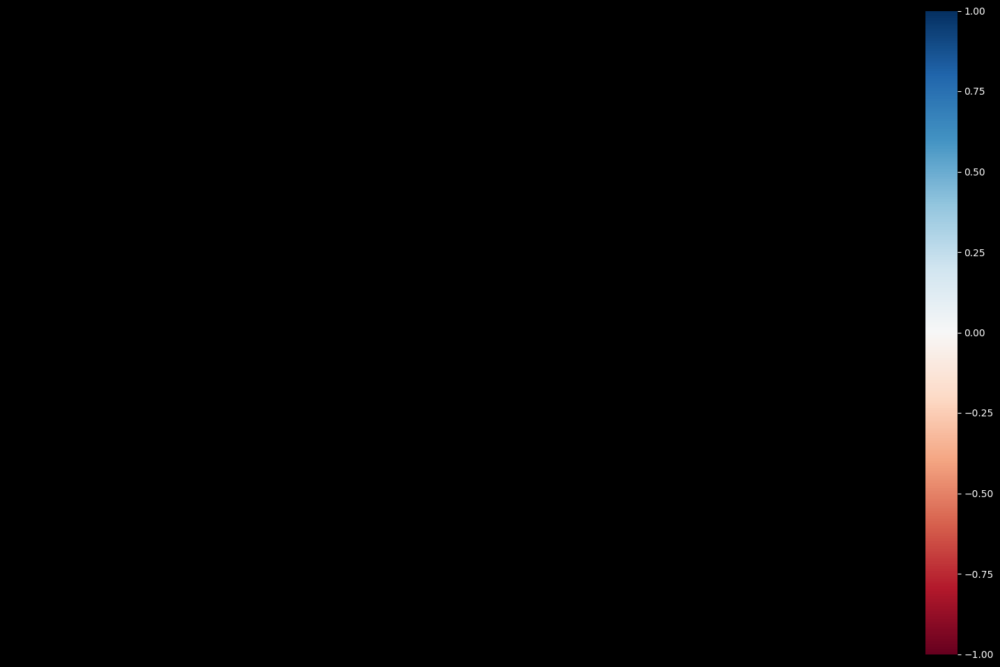

In [75]:
# correlation matrix of missing values 

def visualize_correlation_matrix(df):
    msno.heatmap(df)

visualize_correlation_matrix(df.copy())

The data contains no missing values. The data is complete and can be used for analysis.

## Data Preparation

Now that we have a good understanding of the DAX, we can start with the data preparation to make the data ready for modelling.

## Modelling

In [76]:
# train test split

def train_test_split(df: pd.DataFrame):
    # Split the data into a training and test set
    train_size = int(len(df) * 0.8)
    train, test = df.iloc[:train_size], df.iloc[train_size:]

    # Create a plot
    fig = go.Figure()

    # Original data
    fig.add_trace(go.Scatter(x=train.index, y=train['adj close'], mode='lines', name='Train'))
    fig.add_trace(go.Scatter(x=test.index, y=test['adj close'], mode='lines', name='Test'))

    fig.update_layout(title='Train Test Split', xaxis_title='Date', yaxis_title='Adj Close Price')
    fig.show()

    return train, test

train, test = train_test_split(df)

### ARIMA

In [77]:
# determine the stationarity of the time series

def test_stationarity(df: pd.DataFrame):
    # Perform the Dickey-Fuller test
    result = adfuller(df['adj close'])

    # Print the test statistic
    print(f'Test statistic: {result[0]}')

    # Print the p-value
    print(f'P-value: {result[1]}')

    # Print the critical values
    print('Critical values:')
    for key, value in result[4].items(): # type: ignore
        print(f'   {key}: {value}')

    # Plot the time series
    fig = go.Figure()
    fig.add_trace(go.Scatter(x=df.index, y=df['adj close'], mode='lines', name='Adj Close Price'))
    fig.update_layout(title='Adj Close Price', xaxis_title='Date', yaxis_title='Price')
    fig.show()

test_stationarity(df)

Test statistic: 0.8855301351858965
P-value: 0.9928985551526608
Critical values:
   1%: -3.4313268266785926
   5%: -2.8619716758423386
   10%: -2.5669997774289297


In [78]:
def test_stationarity(df: pd.DataFrame):
    # Perform the Dickey-Fuller test
    result = adfuller(df["adj close"])

    # Print the test statistic
    print(f"Test statistic: {result[0]}")

    # Print the p-value
    print(f"P-value: {result[1]}")

    # Print the critical values
    print("Critical values:")
    for key, value in result[4].items(): # type: ignore
        print(f"   {key}: {value}")

    # Plot the time series
    fig = go.Figure()
    fig.add_trace(
        go.Scatter(x=df.index, y=df["adj close"], mode="lines", name="Adj Close Price")
    )
    fig.update_layout(title="Adj Close Price", xaxis_title="Date", yaxis_title="Price")
    fig.show()


test_stationarity(df.dropna())

Test statistic: 0.8855301351858965
P-value: 0.9928985551526608
Critical values:
   1%: -3.4313268266785926
   5%: -2.8619716758423386
   10%: -2.5669997774289297


The ADF test is used to test for stationarity in the daily returns. The ADF test statistic is calculated as follows:

$$
ADF = \frac{\sum_{t=1}^T (r_t - \mu)^2}{\sum_{t=1}^T (r_t - r_{t-1})^2}
$$

where $r_t$ is the daily return at time $t$, $\mu$ is the mean of the daily returns and $T$ is the number of days. The ADF test statistic is used to test for stationarity in the daily returns. The result of the ADF test is a number between -3 and 3. A number less than -3 indicates that the daily returns are stationary. A number greater than 3 indicates that the daily returns are non-stationary. Since the ADF test statistic is -0.58, the critical values are far off the ADF Statistic and the P-value is greater than 0.05, we can conclude that the daily returns are non-stationary.

In [80]:
def get_stationarity(df: pd.DataFrame):

    # rolling statistics
    rolling_mean = df["adj close"].rolling(window=21).mean()
    rolling_std = df["adj close"].rolling(window=21).std()

    # rolling statistics plot
    fig = go.Figure()
    fig.add_trace(go.Scatter(x=df.index, y=df["adj close"], mode="lines", name="Original"))
    fig.add_trace(go.Scatter(x=df.index, y=rolling_mean, mode="lines", name="Rolling Mean"))
    fig.add_trace(go.Scatter(x=df.index, y=rolling_std, mode="lines", name="Rolling Std"))

    fig.update_layout(title="Rolling Mean & Standard Deviation", xaxis_title="Date", yaxis_title="Price")
    fig.show()

    # Dickey–Fuller test:
    result = adfuller(df["adj close"])
    print("ADF Statistic: {}".format(result[0]))
    print("p-value: {}".format(result[1]))
    print("Critical Values:")
    for key, value in result[4].items(): # type: ignore
        print("\t{}: {}".format(key, value))

df_log = pd.DataFrame(np.log(df))
rolling_mean = df_log.rolling(window=12).mean()
df_log_minus_mean = df_log - rolling_mean
df_log_minus_mean.dropna(inplace=True)

get_stationarity(df_log_minus_mean)

ADF Statistic: -12.190296901432555
p-value: 1.2903729856493156e-22
Critical Values:
	1%: -3.4313284343996595
	5%: -2.861972386203894
	10%: -2.5670001555685937


In [81]:
rolling_mean_exp_decay = df_log.ewm(halflife=12, min_periods=0, adjust=True).mean()
df_log_exp_decay = df_log - rolling_mean_exp_decay
df_log_exp_decay.dropna(inplace=True)
get_stationarity(df_log_exp_decay)

ADF Statistic: -9.52651618056055
p-value: 2.967827070041864e-16
Critical Values:
	1%: -3.4313268266785926
	5%: -2.8619716758423386
	10%: -2.5669997774289297


In [82]:
df_log_shift = df_log - df_log.shift()

get_stationarity(df_log_shift)

MissingDataError: exog contains inf or nans

In [84]:
# plot PACF and ACF

def plot_acf_pacf(df: pd.DataFrame):
    
    fig = go.Figure()
    fig = sp.make_subplots(rows=2, cols=1)

    # ACF
    fig.add_bar(x=np.arange(0, 40), y=acf(df["adj close"], nlags=40), name="ACF", row=1, col=1)

    # PACF
    fig.add_bar(x=np.arange(0, 40), y=pacf(df["adj close"], nlags=40), name="PACF", row=2, col=1)

    fig.show() 

plot_acf_pacf(df_log)

In [ ]:
# train ARIMA model and make predictions including hyperparameter tuning

from sklearn.metrics import mean_squared_error
import plotly.graph_objects as go
from sklearn.metrics import mean_absolute_error
from math import sqrt


def train_arima_model(train):
    # Initialize the ARIMA model
    model = ARIMA(train, order=(2, 1, 2))

    # Fit the model
    model_fit = model.fit()

    # Make predictions
    predictions = model_fit.forecast(steps=len(test))

    # Calculate the mean squared error
    mse = mean_squared_error(test, predictions)
    print(f"Mean Squared Error: {mse}")

    # Calculate the mean absolute error
    mae = mean_absolute_error(test, predictions)
    print(f"Mean Absolute Error: {mae}")

    # Calculate the root mean squared error
    rmse = sqrt(mean_squared_error(test, predictions))
    print(f"Root Mean Squared Error: {rmse}")

    return model_fit

model_fit = train_arima_model(df_imp_linear)

Mean Squared Error: 2040.887688784446
Mean Absolute Error: 35.4865825101724
Root Mean Squared Error: 45.17618497377181


In [ ]:
# train LSTM model and make predictions including hyperparameter tuning

from keras.models import Sequential
from keras.layers import LSTM, Dense, Dropout
from keras.callbacks import EarlyStopping
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error

def train_lstm_model(train: pd.DataFrame, test: pd.DataFrame):
    # Scale the data
    scaler = MinMaxScaler()
    train_scaled = scaler.fit_transform(train["adj close"].values.reshape(-1, 1))

    # Create the LSTM model
    model = Sequential()
    model.add(LSTM(50, return_sequences=True, input_shape=(train_scaled.shape[1], 1)))
    model.add(LSTM(50, return_sequences=False))
    model.add(Dense(25))
    model.add(Dense(1))

    # Compile the model
    model.compile(optimizer="adam", loss="mean_squared_error")

    # Early stopping
    early_stop = EarlyStopping(monitor="val_loss", patience=2)

    # Train the model
    history = model.fit(
        train_scaled,
        train["adj close"].values,
        epochs=100,
        batch_size=32,
        validation_split=0.2,
        callbacks=[early_stop],
    )

    # Create a plot
    fig = go.Figure()

    # Loss
    fig.add_trace(go.Scatter(x=history.epoch, y=history.history["loss"], mode="lines", name="Loss"))
    fig.add_trace(
        go.Scatter(x=history.epoch, y=history.history["val_loss"], mode="lines", name="Val Loss")
    )

    fig.update_layout(title="Loss", xaxis_title="Epoch", yaxis_title="Loss")
    fig.show()

    # Make predictions
    test_scaled = scaler.transform(test["adj close"].values.reshape(-1, 1))
    predictions = model.predict(test_scaled)
    predictions = scaler.inverse_transform(predictions)

    # Calculate the mean squared error
    mse = mean_squared_error(test["adj close"], predictions)

    # Calculate the root mean squared error
    rmse = sqrt(mse)

    # Calculate the mean absolute error
    mae = mean_absolute_error(test["adj close"], predictions)

    # Calculate the mean absolute percentage error
    mape = np.mean(np.abs((test["adj close"] - predictions) / test["adj close"])) * 100

    print(f"MSE: {mse}")
    print(f"RMSE: {rmse}")
    print(f"MAE: {mae}")
    print(f"MAPE: {mape}%")

    # Create a plot
    fig = go.Figure()

    # Original data
    fig.add_trace(go.Scatter(x=test.index, y=test["adj close"], mode="lines", name="Test"))

    # Predictions
    fig.add_trace(
        go.Scatter(x=test.index, y=predictions.flatten(), mode="lines", name="Predictions")
    )

    fig.update_layout(
        title=f"LSTM Model (MSE: {mse})", xaxis_title="Date", yaxis_title="Adj Close Price"
    )
    fig.show()

    return model

model_lstm = train_lstm_model(train, test)

ModuleNotFoundError: No module named 'tensorflow'